# Geographic Analysis of Traffic Accident Severity in Atlanta

In [1]:
import pandas as pd
import numpy as np 
import seaborn as sns 
import matplotlib.pyplot as plt 

In [2]:
df0 = pd.read_csv("traffic_accidents_atlanta.csv")
df0

,Unnamed: 0,ID,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),...,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
0,32596,A-2749196,2,2016-11-30 17:39:56,2016-11-30 23:39:56,33.741530,-84.414340,33.746580,-84.430340,0.983,...,False,False,False,False,False,False,Night,Day,Day,Day
1,32618,A-2749218,2,2016-11-30 18:09:52,2016-12-01 00:09:52,33.912200,-84.383900,33.911380,-84.372580,0.652,...,False,False,False,False,False,False,Night,Night,Day,Day
2,32633,A-2749233,2,2016-11-30 18:44:53,2016-12-01 00:44:53,33.927360,-84.357740,33.986950,-84.339400,4.249,...,False,False,False,False,False,False,Night,Night,Night,Day
3,32642,A-2749242,2,2016-11-30 18:56:16,2016-12-01 00:56:16,33.741360,-84.414020,33.741190,-84.411730,0.132,...,False,False,False,False,False,False,Night,Night,Night,Day
4,32673,A-2749273,2,2016-11-30 20:52:19,2016-12-01 02:52:19,33.759168,-84.378729,33.761590,-84.380800,0.205,...,False,False,False,False,False,False,Night,Night,Night,Night
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11849,1515289,A-4238632,2,2019-08-22 17:00:47,2019-08-22 17:27:52,33.843640,-84.429720,33.848560,-84.430780,0.345,...,False,False,False,False,False,False,Day,Day,Day,Day
11850,1515713,A-4239056,4,2019-08-23 02:01:46,2019-08-23 02:30:39,33.686550,-84.499870,33.694790,-84.499890,0.569,...,False,False,False,False,False,False,Night,Night,Night,Night
11851,1515735,A-4239078,2,2019-08-23 19:05:00,2019-08-23 19:33:49,33.868000,-84.285130,33.860690,-84.292680,0.665,...,False,False,False,False,False,False,Day,Day,Day,Day
11852,1515739,A-4239082,2,2019-08-23 20:43:54,2019-08-23 21:13:18,33.920200,-84.320150,33.920190,-84.314810,0.306,...,False,False,False,False,False,False,Night,Night,Day,Day


In [3]:
DeepnoteChart(df0, """{"mark":{"clip":true,"type":"area","color":"#4c78a8","tooltip":true},"config":{"legend":{}},"$schema":"https://vega.github.io/schema/vega-lite/v5.json","encoding":{"x":{"sort":null,"scale":{"type":"linear"},"stack":"zero"},"y":{"sort":null,"scale":{"type":"linear"},"stack":"zero"}}}""")

## fixing and quantizing the data (cleanup part 1)

In [4]:
df = df0.drop(columns=['Unnamed: 0', 'ID', 'Description', 'Number', 
'Street',
'City',
'State',
'Zipcode',
'Country',
'County',
'Airport_Code',
'Timezone',
'Bump',
'Roundabout',
'Traffic_Calming',
'Turning_Loop',
'Civil_Twilight',
'Nautical_Twilight',
'Astronomical_Twilight'])
df

,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Side,Weather_Timestamp,...,Junction,No_Exit,Railway,Station,Stop,Traffic_Signal,Sunrise_Sunset,Is_Calm,SideN,Time_of_Day
0,2,2016-11-30 17:39:56,2016-11-30 23:39:56,33.741530,-84.414340,33.746580,-84.430340,0.983,R,2016-11-30 17:46:00,...,0,0,0,0,0,0,Night,0,1,1
1,2,2016-11-30 18:09:52,2016-12-01 00:09:52,33.912200,-84.383900,33.911380,-84.372580,0.652,R,2016-11-30 18:04:00,...,1,0,0,0,0,0,Night,0,1,1
2,2,2016-11-30 18:44:53,2016-12-01 00:44:53,33.927360,-84.357740,33.986950,-84.339400,4.249,R,2016-11-30 18:53:00,...,0,0,0,0,0,0,Night,0,1,1
3,2,2016-11-30 18:56:16,2016-12-01 00:56:16,33.741360,-84.414020,33.741190,-84.411730,0.132,R,2016-11-30 18:52:00,...,0,0,0,0,0,0,Night,0,1,1
4,2,2016-11-30 20:52:19,2016-12-01 02:52:19,33.759168,-84.378729,33.761590,-84.380800,0.205,R,2016-11-30 20:52:00,...,0,0,0,0,0,0,Night,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11849,2,2019-08-22 17:00:47,2019-08-22 17:27:52,33.843640,-84.429720,33.848560,-84.430780,0.345,R,2019-08-22 16:56:00,...,0,0,0,0,0,0,Day,0,1,0
11850,4,2019-08-23 02:01:46,2019-08-23 02:30:39,33.686550,-84.499870,33.694790,-84.499890,0.569,R,2019-08-23 01:53:00,...,1,0,0,0,0,0,Night,1,1,1
11851,2,2019-08-23 19:05:00,2019-08-23 19:33:49,33.868000,-84.285130,33.860690,-84.292680,0.665,R,2019-08-23 18:53:00,...,0,0,0,0,0,0,Day,0,1,0
11852,2,2019-08-23 20:43:54,2019-08-23 21:13:18,33.920200,-84.320150,33.920190,-84.314810,0.306,R,2019-08-23 20:53:00,...,1,0,0,0,0,0,Night,0,1,1


In [42]:
DeepnoteChart(df, """{"layer":[{"layer":[{"mark":{"clip":true,"type":"bar","color":"#4c78a8","tooltip":true},"encoding":{"x":{"sort":null,"type":"quantitative","field":"Time_of_Day","scale":{"type":"linear"},"format":{"type":"default","decimals":null},"formatType":"numberFormatFromNumberType"},"y":{"sort":null,"type":"quantitative","field":"Severity","scale":{"type":"linear"},"format":{"type":"default","decimals":null},"aggregate":"sum","formatType":"numberFormatFromNumberType"}}}]}],"title":"","config":{"legend":{}},"$schema":"https://vega.github.io/schema/vega-lite/v5.json","encoding":{}}""")

In [5]:
print(df.dtypes)

Severity               int64
Start_Time            object
End_Time              object
Start_Lat            float64
Start_Lng            float64
End_Lat              float64
End_Lng              float64
Distance(mi)         float64
Side                  object
Weather_Timestamp     object
Temperature(F)       float64
Wind_Chill(F)        float64
Humidity(%)          float64
Pressure(in)         float64
Visibility(mi)       float64
Wind_Direction        object
Wind_Speed(mph)      float64
Precipitation(in)    float64
Weather_Condition     object
Amenity                 bool
Crossing                bool
Give_Way                bool
Junction                bool
No_Exit                 bool
Railway                 bool
Station                 bool
Stop                    bool
Traffic_Signal          bool
Sunrise_Sunset        object
dtype: object


In [6]:
df['Amenity'] = df['Amenity'].astype(int)
df['Crossing'] = df['Crossing'].astype(int)
df['Give_Way'] = df['Give_Way'].astype(int)
df['Junction'] = df['Junction'].astype(int)
df['No_Exit'] = df['No_Exit'].astype(int)
df['Railway'] = df['Railway'].astype(int)
df['Station'] = df['Station'].astype(int)
df['Stop'] = df['Stop'].astype(int)
df['Traffic_Signal'] = df['Traffic_Signal'].astype(int)
df['Start_Time'] = pd.to_datetime(df['Start_Time'])
df['End_Time'] = pd.to_datetime(df['End_Time'])
df['Weather_Timestamp'] = pd.to_datetime(df['Weather_Timestamp'])
df

print(df.dtypes)

Severity                      int64
Start_Time           datetime64[ns]
End_Time             datetime64[ns]
Start_Lat                   float64
Start_Lng                   float64
End_Lat                     float64
End_Lng                     float64
Distance(mi)                float64
Side                         object
Weather_Timestamp    datetime64[ns]
Temperature(F)              float64
Wind_Chill(F)               float64
Humidity(%)                 float64
Pressure(in)                float64
Visibility(mi)              float64
Wind_Direction               object
Wind_Speed(mph)             float64
Precipitation(in)           float64
Weather_Condition            object
Amenity                       int64
Crossing                      int64
Give_Way                      int64
Junction                      int64
No_Exit                       int64
Railway                       int64
Station                       int64
Stop                          int64
Traffic_Signal              

In [7]:
df

,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Side,Weather_Timestamp,...,Amenity,Crossing,Give_Way,Junction,No_Exit,Railway,Station,Stop,Traffic_Signal,Sunrise_Sunset
0,2,2016-11-30 17:39:56,2016-11-30 23:39:56,33.741530,-84.414340,33.746580,-84.430340,0.983,R,2016-11-30 17:46:00,...,0,0,0,0,0,0,0,0,0,Night
1,2,2016-11-30 18:09:52,2016-12-01 00:09:52,33.912200,-84.383900,33.911380,-84.372580,0.652,R,2016-11-30 18:04:00,...,0,0,0,1,0,0,0,0,0,Night
2,2,2016-11-30 18:44:53,2016-12-01 00:44:53,33.927360,-84.357740,33.986950,-84.339400,4.249,R,2016-11-30 18:53:00,...,0,0,0,0,0,0,0,0,0,Night
3,2,2016-11-30 18:56:16,2016-12-01 00:56:16,33.741360,-84.414020,33.741190,-84.411730,0.132,R,2016-11-30 18:52:00,...,0,0,0,0,0,0,0,0,0,Night
4,2,2016-11-30 20:52:19,2016-12-01 02:52:19,33.759168,-84.378729,33.761590,-84.380800,0.205,R,2016-11-30 20:52:00,...,0,0,0,0,0,0,0,0,0,Night
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11849,2,2019-08-22 17:00:47,2019-08-22 17:27:52,33.843640,-84.429720,33.848560,-84.430780,0.345,R,2019-08-22 16:56:00,...,0,0,0,0,0,0,0,0,0,Day
11850,4,2019-08-23 02:01:46,2019-08-23 02:30:39,33.686550,-84.499870,33.694790,-84.499890,0.569,R,2019-08-23 01:53:00,...,0,0,0,1,0,0,0,0,0,Night
11851,2,2019-08-23 19:05:00,2019-08-23 19:33:49,33.868000,-84.285130,33.860690,-84.292680,0.665,R,2019-08-23 18:53:00,...,0,0,0,0,0,0,0,0,0,Day
11852,2,2019-08-23 20:43:54,2019-08-23 21:13:18,33.920200,-84.320150,33.920190,-84.314810,0.306,R,2019-08-23 20:53:00,...,0,0,0,1,0,0,0,0,0,Night


In [8]:
DeepnoteChart(df, """{"layer":[{"mark":{"clip":true,"type":"bar","color":"#4c78a8","tooltip":true},"encoding":{"x":{"sort":null,"type":"quantitative","field":"Severity","scale":{"type":"linear"}},"y":{"sort":null,"type":"quantitative","scale":{"type":"linear"},"aggregate":"count"}}}],"title":"","config":{"legend":{}},"$schema":"https://vega.github.io/schema/vega-lite/v5.json","encoding":{}}""")

In [9]:
df['Is_Calm'] = df['Wind_Direction'].apply(lambda direction: 1 if direction == "CALM" else 0)
df['Is_Calm']

0        0
1        0
2        0
3        0
4        0
        ..
11849    0
11850    1
11851    0
11852    0
11853    0
Name: Is_Calm, Length: 11854, dtype: int64

In [10]:
df['SideN'] = df['Side'].apply(lambda side: 1 if side == "R" else 0)
df['SideN']

0        1
1        1
2        1
3        1
4        1
        ..
11849    1
11850    1
11851    1
11852    1
11853    1
Name: SideN, Length: 11854, dtype: int64

In [11]:
df['Time_of_Day'] = df['Sunrise_Sunset'].apply(lambda sun: 1 if sun == "Night" else 0)
df['Time_of_Day']

0        1
1        1
2        1
3        1
4        1
        ..
11849    0
11850    1
11851    0
11852    1
11853    1
Name: Time_of_Day, Length: 11854, dtype: int64

In [12]:
df = df.drop(columns=['Wind_Direction', 'Side', 'Sunrise_Sunset'])
df

,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Weather_Timestamp,Temperature(F),...,Give_Way,Junction,No_Exit,Railway,Station,Stop,Traffic_Signal,Is_Calm,SideN,Time_of_Day
0,2,2016-11-30 17:39:56,2016-11-30 23:39:56,33.741530,-84.414340,33.746580,-84.430340,0.983,2016-11-30 17:46:00,62.6,...,0,0,0,0,0,0,0,0,1,1
1,2,2016-11-30 18:09:52,2016-12-01 00:09:52,33.912200,-84.383900,33.911380,-84.372580,0.652,2016-11-30 18:04:00,63.0,...,0,1,0,0,0,0,0,0,1,1
2,2,2016-11-30 18:44:53,2016-12-01 00:44:53,33.927360,-84.357740,33.986950,-84.339400,4.249,2016-11-30 18:53:00,61.0,...,0,0,0,0,0,0,0,0,1,1
3,2,2016-11-30 18:56:16,2016-12-01 00:56:16,33.741360,-84.414020,33.741190,-84.411730,0.132,2016-11-30 18:52:00,62.1,...,0,0,0,0,0,0,0,0,1,1
4,2,2016-11-30 20:52:19,2016-12-01 02:52:19,33.759168,-84.378729,33.761590,-84.380800,0.205,2016-11-30 20:52:00,57.0,...,0,0,0,0,0,0,0,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11849,2,2019-08-22 17:00:47,2019-08-22 17:27:52,33.843640,-84.429720,33.848560,-84.430780,0.345,2019-08-22 16:56:00,91.0,...,0,0,0,0,0,0,0,0,1,0
11850,4,2019-08-23 02:01:46,2019-08-23 02:30:39,33.686550,-84.499870,33.694790,-84.499890,0.569,2019-08-23 01:53:00,79.0,...,0,1,0,0,0,0,0,1,1,1
11851,2,2019-08-23 19:05:00,2019-08-23 19:33:49,33.868000,-84.285130,33.860690,-84.292680,0.665,2019-08-23 18:53:00,85.0,...,0,0,0,0,0,0,0,0,1,0
11852,2,2019-08-23 20:43:54,2019-08-23 21:13:18,33.920200,-84.320150,33.920190,-84.314810,0.306,2019-08-23 20:53:00,80.0,...,0,1,0,0,0,0,0,0,1,1


In [13]:
df['Weather_Condition'].unique()

array(['Mostly Cloudy', 'Overcast', 'Scattered Clouds', 'Clear',
       'Partly Cloudy', 'Light Rain', 'Rain', 'Light Drizzle', 'Haze',
       'Mist', 'Fog', 'Light Thunderstorms and Rain',
       'Thunderstorms and Rain', 'Light Snow',
       'Heavy Thunderstorms and Rain', nan, 'Smoke', 'Heavy Rain',
       'Thunderstorm', 'Cloudy', 'Fair', 'Rain / Windy',
       'Light Drizzle / Windy', 'Partly Cloudy / Windy',
       'Light Rain / Windy', 'Wintry Mix / Windy', 'Heavy Rain / Windy',
       'Cloudy / Windy', 'Drizzle and Fog', 'T-Storm', 'Fair / Windy',
       'Light Snow / Windy', 'Thunder in the Vicinity', 'Thunder',
       'Light Rain with Thunder', 'Heavy T-Storm',
       'Mostly Cloudy / Windy', 'Rain Shower', 'Light Rain Showers',
       'Light Ice Pellets'], dtype=object)

cloudy (2) = "Mostly Cloudy", "Overcast", "Scattered Clouds", "Partly Cloudy", "Cloudy", "Haze", "Fog", "Smoke"
rain (3) = "Light Rain", "Rain", "Light Drizzle", "Heavy Rain", "Mist", "Rain Shower", "Light Rain Shower", "Drizzle and Fog"
clear (0) = "Clear", "Fair"
thunderstorms (4) = "Light Thunderstorms and Rain", "Thunderstorms and Rain", "Heavy Thunderstorm and Rain", "Thunderstorm", "T-Storm", "Thunder in the Vicinity", "Thunder", "Light Rain with Thunder", "Heavy T-Storm"
windy (1) = "Rain / Windy", "Light Drizzle / Windy", "Partly Cloudy / Windy", "Light Rain / Windy", "Heavy Rain / Windy", "Cloudy / Windy", "Fair / Windy", "Light Snow / Windy", "Mostly Cloudy / Windy"
snowy conditions (5) = "Light Snow", "Wintry Mix / Windy", "Light Ice Pellets"

In [14]:
df['Snowy'] = df['Weather_Condition'].apply(lambda weather: 1 if weather == "Light Snow" or weather == "Wintry Mix / Windy" or weather == "Light Ice Pellets" else 0)
df['Tstorms'] = df['Weather_Condition'].apply(lambda weather: 1 if weather == "Light Thunderstorms and Rain" or weather == "Thunderstorm and Rain" or weather == "Heavy Thunderstorm and Rain" or weather == "Thunderstorm" or weather == "T-Storm" or weather == "Thunder in the Vicinity" or weather == "Thunder" or weather == "Light Rain with Thunder" or weather == "Heavy T-Storm" else 0)
df['Rain'] = df['Weather_Condition'].apply(lambda weather: 1 if weather == "Light Rain" or weather == "Rain" or weather == "Light Drizzle" or weather == "Heavy Rain" or weather == "Mist" or weather == "Rain Shower" or weather == "Light Rain Shower" or weather == "Drizzle and Fog" else 0)
df['Cloudy'] = df['Weather_Condition'].apply(lambda weather: 1 if weather == "Mostly Cloudy" or weather == "Overcast" or weather == "Scattered Clouds" or weather == "Partly Cloudy" or weather == "Cloudy" or weather == "Haze" or weather == "Fog" or weather == "Smoke" else 0)
df['Windy'] = df['Weather_Condition'].apply(lambda weather: 1 if weather == "Rain / Windy" or weather == "Light Drizzle / Windy" or weather == "Partly Cloudy / Weather" or weather == "Light Rain / Windy" or weather == "Heavy Rain / Weather" or weather == "Cloudy / Windy" or weather == "Fair / Windy" or weather == "Light Snow / Windy" or weather == "Mostly Cloudy / Windy" else 0)
df['Clear'] = df['Weather_Condition'].apply(lambda weather: 1 if weather == "Clear" or weather == "Fair" else 0)

In [15]:
df = df.drop(columns=['Weather_Condition'])
df

,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Weather_Timestamp,Temperature(F),...,Traffic_Signal,Is_Calm,SideN,Time_of_Day,Snowy,Tstorms,Rain,Cloudy,Windy,Clear
0,2,2016-11-30 17:39:56,2016-11-30 23:39:56,33.741530,-84.414340,33.746580,-84.430340,0.983,2016-11-30 17:46:00,62.6,...,0,0,1,1,0,0,0,1,0,0
1,2,2016-11-30 18:09:52,2016-12-01 00:09:52,33.912200,-84.383900,33.911380,-84.372580,0.652,2016-11-30 18:04:00,63.0,...,0,0,1,1,0,0,0,1,0,0
2,2,2016-11-30 18:44:53,2016-12-01 00:44:53,33.927360,-84.357740,33.986950,-84.339400,4.249,2016-11-30 18:53:00,61.0,...,0,0,1,1,0,0,0,1,0,0
3,2,2016-11-30 18:56:16,2016-12-01 00:56:16,33.741360,-84.414020,33.741190,-84.411730,0.132,2016-11-30 18:52:00,62.1,...,0,0,1,1,0,0,0,1,0,0
4,2,2016-11-30 20:52:19,2016-12-01 02:52:19,33.759168,-84.378729,33.761590,-84.380800,0.205,2016-11-30 20:52:00,57.0,...,0,0,1,1,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11849,2,2019-08-22 17:00:47,2019-08-22 17:27:52,33.843640,-84.429720,33.848560,-84.430780,0.345,2019-08-22 16:56:00,91.0,...,0,0,1,0,0,0,0,1,0,0
11850,4,2019-08-23 02:01:46,2019-08-23 02:30:39,33.686550,-84.499870,33.694790,-84.499890,0.569,2019-08-23 01:53:00,79.0,...,0,1,1,1,0,0,0,0,0,1
11851,2,2019-08-23 19:05:00,2019-08-23 19:33:49,33.868000,-84.285130,33.860690,-84.292680,0.665,2019-08-23 18:53:00,85.0,...,0,0,1,0,0,0,0,1,0,0
11852,2,2019-08-23 20:43:54,2019-08-23 21:13:18,33.920200,-84.320150,33.920190,-84.314810,0.306,2019-08-23 20:53:00,80.0,...,0,0,1,1,0,0,0,0,0,1


## getting rid of null values (data cleanup part 2)

<AxesSubplot: >

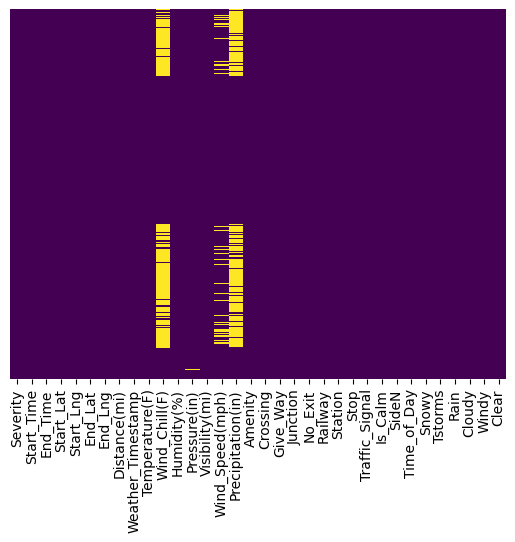

In [16]:
sns.heatmap(df.isnull(), yticklabels=False, cbar=False, cmap="viridis")

<AxesSubplot: xlabel='Severity', ylabel='Wind_Chill(F)'>

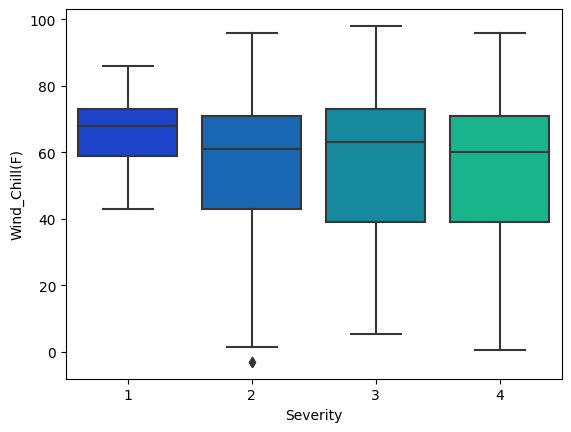

In [17]:
sns.boxplot(x="Severity", y="Wind_Chill(F)", data=df, palette='winter')

In [18]:
# impute wind chill function
def impute_wc(cols):
    windchill = cols[0]
    severity = cols[1]

    if pd.isnull(windchill):
        if severity == 1:
            return 68
        elif severity == 2:
            return 61
        elif severity == 3:
            return 63
        else:
            return 60
    else:
        return windchill
# applying the impute function
df['Wind_Chill(F)'] = df[['Wind_Chill(F)', 'Severity']].apply(impute_wc, axis=1)


<AxesSubplot: xlabel='Severity', ylabel='Precipitation(in)'>

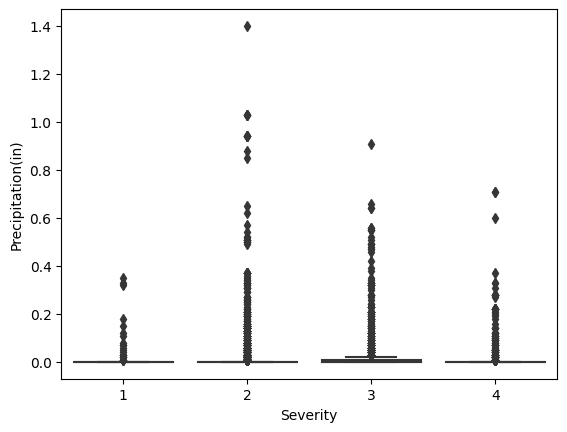

In [19]:
sns.boxplot(x="Severity", y="Precipitation(in)", data=df, palette='winter')

In [20]:
# impute precipitation function
def impute_p(cols):
    precip = cols[0]
    sev = cols[1]

    if pd.isnull(precip):
        if sev == 1:
            return 0.005
        elif sev == 2:
            return 0.01
        elif sev == 3:
            return 0.025
        else:
            return 0.0075
    else:
        return precip
# applying the impute function
df['Precipitation(in)'] = df[['Precipitation(in)', 'Severity']].apply(impute_p, axis=1)

<AxesSubplot: xlabel='Severity', ylabel='Wind_Speed(mph)'>

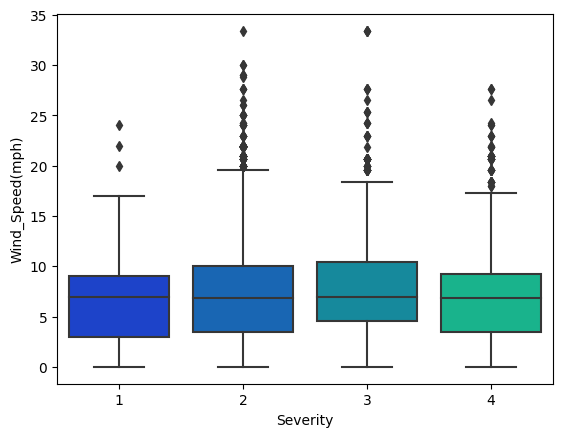

In [21]:
sns.boxplot(x="Severity", y="Wind_Speed(mph)", data=df, palette='winter')

In [22]:
# impute wind speed function
def impute_ws(cols):
    windspeed = cols[0]
    severe = cols[1]

    if pd.isnull(windspeed):
        if severe == 1:
            return 6.8
        elif severe == 2:
            return 6.7
        elif severe == 3:
            return 6.9
        else:
            return 6.55
    else:
        return windspeed
# applying the impute function
df['Wind_Speed(mph)'] = df[['Wind_Speed(mph)', 'Severity']].apply(impute_ws, axis=1)

In [23]:
df = df.dropna(axis=0)

<AxesSubplot: >

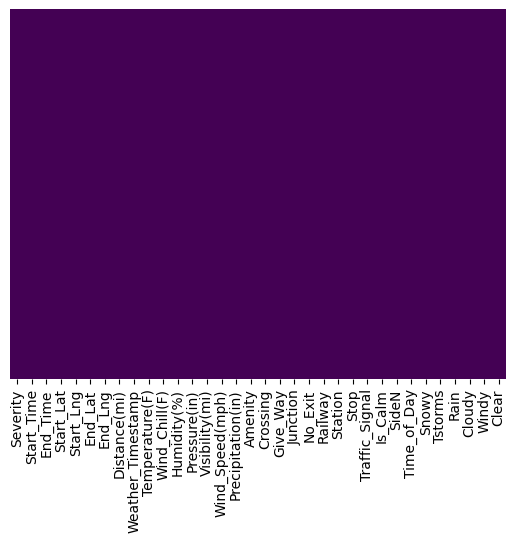

In [24]:
sns.heatmap(df.isnull(), yticklabels=False, cbar=False, cmap="viridis")

## graphing eda

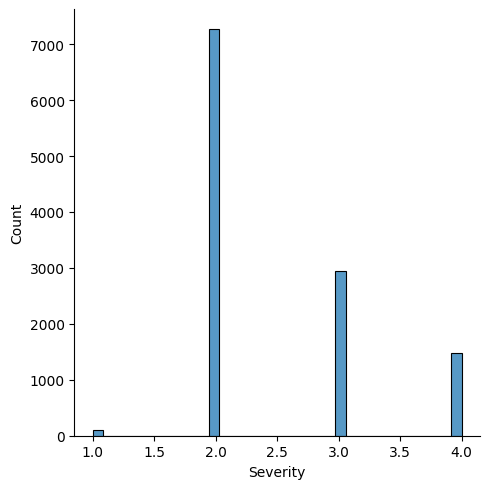

In [25]:
sns.displot(df, x="Severity")

<AxesSubplot: xlabel='Wind_Speed(mph)', ylabel='Count'>

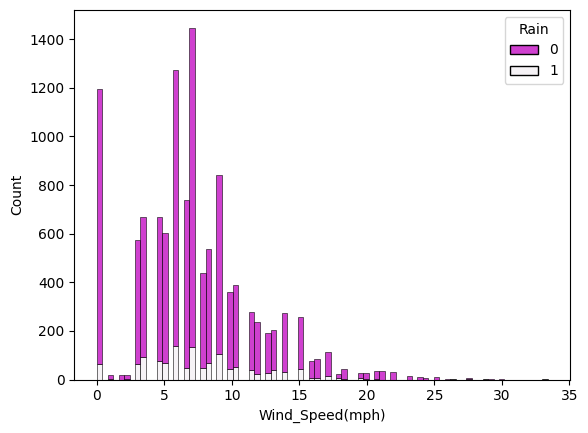

In [26]:
sns.histplot(df, x="Wind_Speed(mph)", hue="Rain", multiple="stack", palette="light:m_r")

/tmp/ipykernel_143/1137570314.py:1: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(df, x="Distance(mi)", y="Visibility(mi)", palette="crest")


<AxesSubplot: xlabel='Distance(mi)', ylabel='Visibility(mi)'>

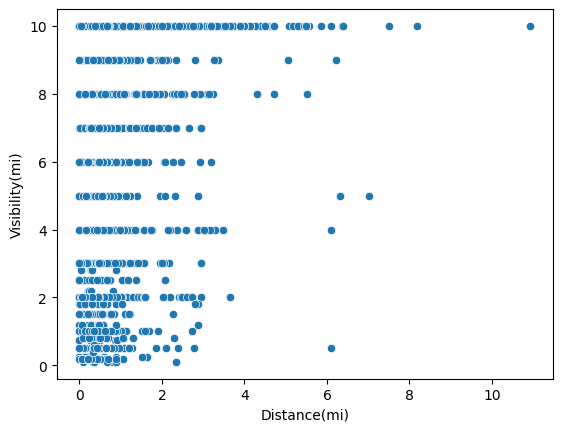

In [27]:
sns.scatterplot(df, x="Distance(mi)", y="Visibility(mi)", palette="crest")

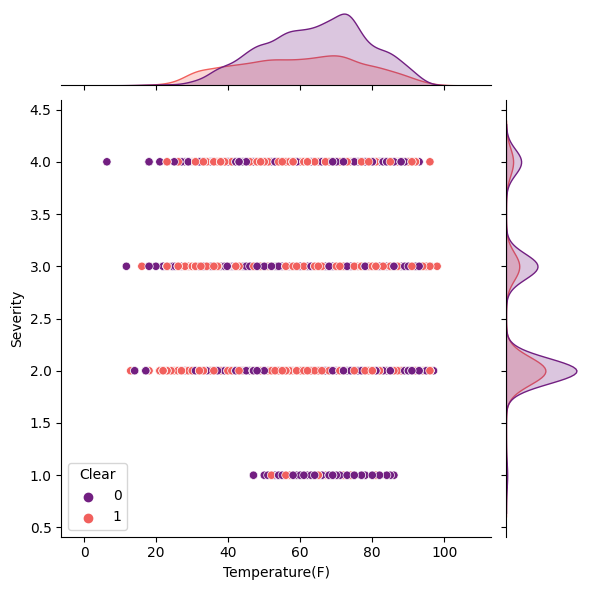

In [28]:
sns.jointplot(df, x="Temperature(F)", y="Severity", hue="Clear", palette="magma")

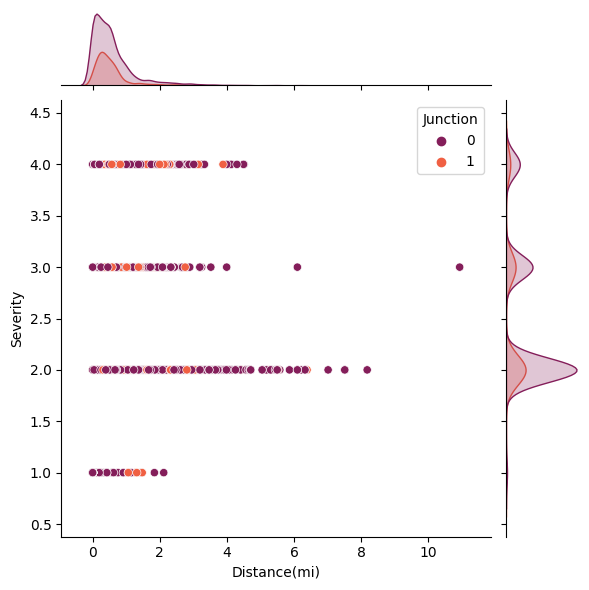

In [29]:
sns.jointplot(df, x="Distance(mi)", y="Severity", hue="Junction", palette="rocket")

<AxesSubplot: xlabel='Start_Time', ylabel='Severity'>

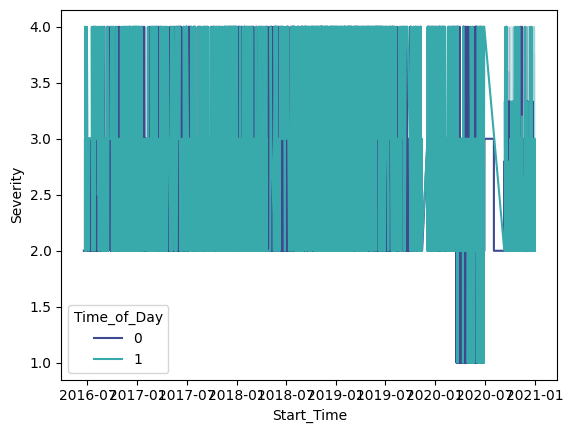

In [30]:
# THING TO DO FOR FUTURE: MAKE A NEW COLUMN CALLED YEAR AND MARK DOWN THE YEAR WHEN THE CRASH OCCURED BASED ON START TIME
# THEN GRAPH THE YEAR ON THE X AXIS AND AVG SEVERITY ON THE Y IN THAT GIVEN YEAR WITH HUE OFF


sns.lineplot(df, x="Start_Time", y="Severity", hue="Time_of_Day", palette="mako")

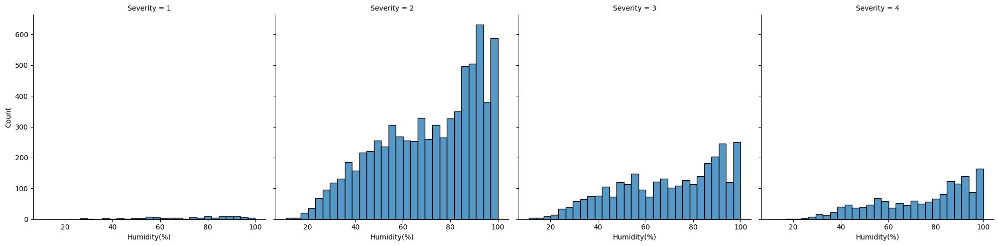

In [31]:
sns.displot(df, x="Humidity(%)", col="Severity")

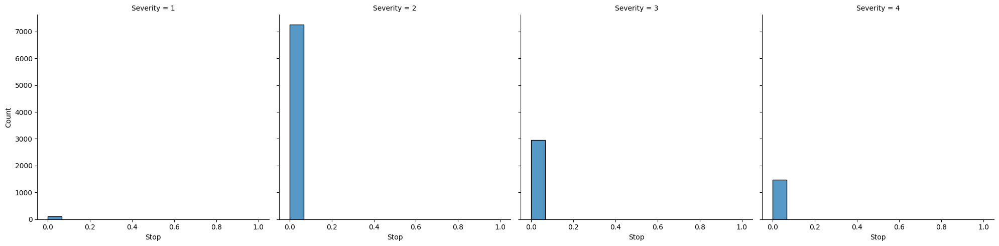

In [32]:
sns.displot(df, x="Stop", col="Severity")

## folium map

In [33]:
import folium
from folium.plugins import HeatMap
import matplotlib.pyplot as plt

In [34]:
LATITUDE = 33.7488
LONGITUDE = -84.3877
m = folium.Map(location=[LATITUDE, LONGITUDE], zoom_start=11)
HeatMap(df[['Start_Lat', 'Start_Lng']].values).add_to(m)
m

In [35]:
df['Weather_Timestamp']

0       2016-11-30 17:46:00
1       2016-11-30 18:04:00
2       2016-11-30 18:53:00
3       2016-11-30 18:52:00
4       2016-11-30 20:52:00
                ...        
11849   2019-08-22 16:56:00
11850   2019-08-23 01:53:00
11851   2019-08-23 18:53:00
11852   2019-08-23 20:53:00
11853   2019-08-23 20:53:00
Name: Weather_Timestamp, Length: 11798, dtype: datetime64[ns]

## machine learning part

/tmp/ipykernel_143/747729917.py:15: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated.  Please use Series.dt.isocalendar().week instead.
  df[timestamp_column + '_week'] = df[timestamp_column].dt.week
/shared-libs/python3.9/py/lib/python3.9/site-packages/sklearn/ensemble/_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
0.6759470806543671


([0,
  1,
  2,
  3,
  4,
  5,
  6,
  7,
  8,
  9,
  10,
  11,
  12,
  13,
  14,
  15,
  16,
  17,
  18,
  19,
  20,
  21,
  22,
  23,
  24,
  25,
  26,
  27,
  28,
  29,
  30,
  31,
  32,
  33,
  34,
  35,
  36,
  37,
  38,
  39,
  40,
  41,
  42,
  43,
  44],
 [Text(0, 0, 'Snowy'),
  Text(1, 0, 'Station'),
  Text(2, 0, 'No_Exit'),
  Text(3, 0, 'Give_Way'),
  Text(4, 0, 'Amenity'),
  Text(5, 0, 'Stop'),
  Text(6, 0, 'Is_Calm'),
  Text(7, 0, 'End_Time_year'),
  Text(8, 0, 'Clear'),
  Text(9, 0, 'Start_Time_year'),
  Text(10, 0, 'Weather_Timestamp_year'),
  Text(11, 0, 'Cloudy'),
  Text(12, 0, 'Crossing'),
  Text(13, 0, 'Tstorms'),
  Text(14, 0, 'Junction'),
  Text(15, 0, 'Weather_Timestamp_month'),
  Text(16, 0, 'Start_Time_month'),
  Text(17, 0, 'Railway'),
  Text(18, 0, 'End_Time_week'),
  Text(19, 0, 'Rain'),
  Text(20, 0, 'End_Time_month'),
  Text(21, 0, 'Start_Lat'),
  Text(22, 0, 'End_Lat'),
  Text(23, 0, 'Visibility(mi)'),
  Text(24, 0, 'Traffic_Signal'),
  Text(25, 0, 'Windy'),


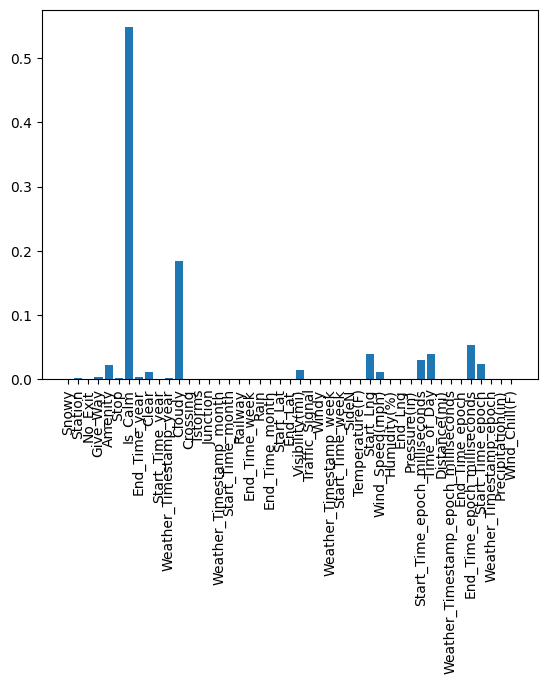

In [36]:
import sklearn as skl
from sklearn.ensemble import GradientBoostingRegressor

features = list(df.columns)
features.remove('Severity')
target = ['Severity']

xdf = df.dropna()

X = xdf[features]

def convert_timestamp_column(df, timestamp_column):
    df[timestamp_column + '_epoch'] = df[timestamp_column].apply(lambda x: x.timestamp() if not pd.isnull(x) else x)
    df[timestamp_column + '_epoch_milliseconds'] = df[timestamp_column + '_epoch'] * 1000
    df[timestamp_column + '_week'] = df[timestamp_column].dt.week
    df[timestamp_column + '_month'] = df[timestamp_column].dt.month
    df[timestamp_column + '_year'] = df[timestamp_column].dt.year
    df.drop(columns=[timestamp_column], inplace=True)

for ts_col in [x for x in X.columns if X[x].dtype == '<M8[ns]']:
    convert_timestamp_column(X, ts_col)

cats =  [x for x in X.columns if X[x].dtype == 'O']
X[cats] = X[cats].astype('category').apply(lambda x: x.cat.codes)
Y = xdf[target]

model = GradientBoostingRegressor()
model.fit(X, Y)

acc = model.score(X, Y)
print(acc)


plt.bar(X.columns[np.argsort(model.feature_importances_)], model.feature_importances_)
plt.xticks(rotation=90)

In [37]:
from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.3)

from sklearn.linear_model import SGDClassifier
clf = SGDClassifier(loss="log_loss", penalty="l2", max_iter=5)
clf.fit(X_train, Y_train)

trainacc = clf.score(X_train, Y_train)
testacc = clf.score(X_test, Y_test)
print(trainacc)
print(testacc)

0.24872850569145072
0.2533898305084746
/shared-libs/python3.9/py/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/shared-libs/python3.9/py/lib/python3.9/site-packages/sklearn/linear_model/_stochastic_gradient.py:705: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


<a style='text-decoration:none;line-height:16px;display:flex;color:#5B5B62;padding:10px;justify-content:end;' href='https://deepnote.com?utm_source=created-in-deepnote-cell&projectId=02febca0-0f38-42d8-8cd3-0bddd5c2f437' target="_blank">
 </img>
Created in <span style='font-weight:600;margin-left:4px;'>Deepnote</span></a>